# Open Street Map Exploration of Plovdiv

This file contains some EDA from OpenStreetMap of the Bulgarian city of Plovdiv. It should be kept in mind that data is taken from OSM, so it may be that not everything is coded, but still a general idea should be able to be taken into account.

#### Imports

In [1]:
import pyrosm
from pyrosm.data import sources
import matplotlib.pyplot as plt

In [3]:
import geopandas as gpd

In [11]:
import os

In [4]:
import osmnx  as ox
import pandas as pd
from shapely.geometry import Point, LineString

### Extract Plovdiv from the Municipalities geojson file

In [6]:
municipalities = gpd.read_file("https://raw.githubusercontent.com/atanasova16/GeospatialAnalysisProject/main/Analysis_and_Exploration/Data/Bulgaria_gdf/municipalities.geojson")
plovdiv_city = municipalities[municipalities.nuts4 == "PDV22"]


In [3]:
# municipalities = gpd.read_file("C:\\Users\\User\\Documents\\UNITN\\Geospatial\\raster\\municipalities.geojson")
# municipalities.crs #4326
# plovdiv_city = municipalities[municipalities.nuts4 == "PDV22"]
# plovdiv_city

,nuts4,nuts3,geometry
260,PDV22,PDV,"POLYGON ((24.76400 42.19200, 24.77800 42.17600..."


In [7]:
plovdiv_city['name'] = "Plovdiv"

c:\Users\User\anaconda3\envs\geospatialenv\lib\site-packages\geopandas\geodataframe.py:1443: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)


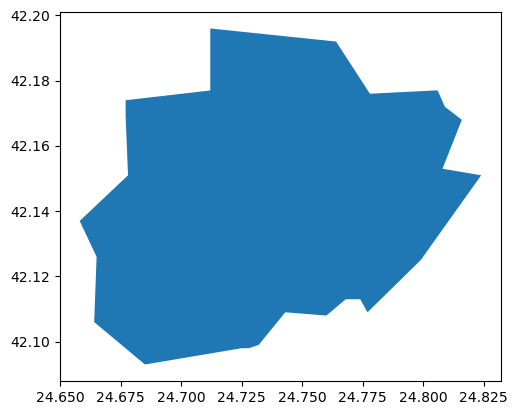

In [8]:
plovdiv_city.plot()

In [ ]:
plovdiv_city.explore()

In [7]:
plovdiv_city.to_crs(32635).geometry.area/10**6

260    101.201118
dtype: float64

In [9]:
bbox_geom = plovdiv_city['geometry'].values[0]

# Exploring Plovdiv

Data (pbf) exported using BBBike data (https://extract.bbbike.org/)

In [6]:
#osm3 = pyrosm.OSM(r"C:\Users\User\Documents\UNITN\Geospatial\raster\osm_pbf\bbbike\planet_24.658,42.104_24.824,42.184.osm.pbf", bounding_box= bbox_geom)

In [12]:
# Retrieve the pbf file
url_pld = "https://github.com/atanasova16/GeospatialAnalysisProject/raw/main/Analysis_and_Exploration/Data/OSM_BBBike/pld.osm.pbf"
filename = "pld.osm.pbf"
import requests
r = requests.get(url_pld, allow_redirects=True)
open(os.path.join(os.getcwd(), filename), 'wb').write(r.content)

osm3 = pyrosm.OSM(os.path.join(os.getcwd(), filename), bounding_box=bbox_geom)

In [13]:
osm3.conf.tags.available

['aerialway',
 'aeroway',
 'amenity',
 'boundary',
 'building',
 'craft',
 'emergency',
 'geological',
 'highway',
 'historic',
 'landuse',
 'leisure',
 'natural',
 'office',
 'power',
 'public_transport',
 'railway',
 'route',
 'place',
 'shop',
 'tourism',
 'waterway']

## Buildings of Plovdiv

We can get an idea of what and where is located. Actually a lot of the buildings are defined as a "yes" without a specific tag. The residential buildings take the most of space, which is a normal thing.

c:\Users\User\anaconda3\envs\geospatialenv\lib\site-packages\geopandas\array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 (the single non-null crs provided).
  warnings.warn(


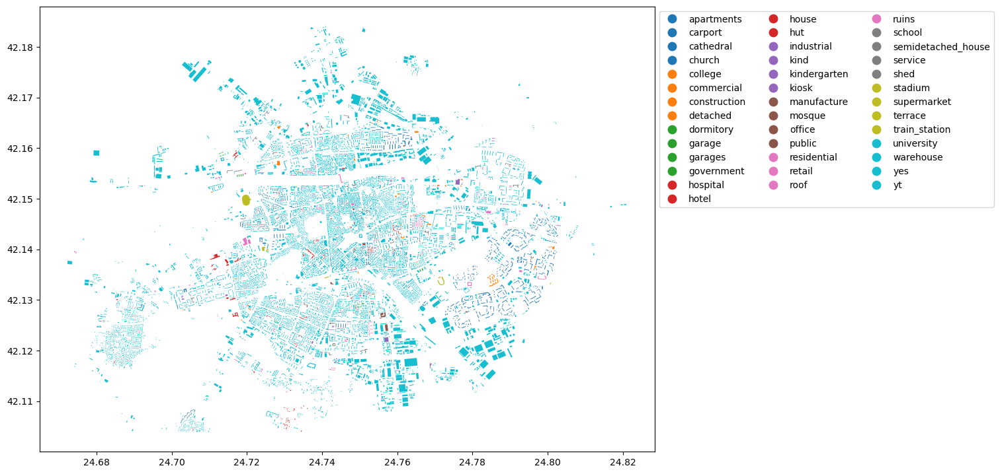

In [14]:
buildings = osm3.get_buildings()
buildings.plot(column="building", figsize=(12,12), legend=True, legend_kwds=dict(loc='upper left', ncol=3, bbox_to_anchor=(1, 1)))
plt.show()

In [18]:
buildings.building.head()

0              yes
1              yes
2    train_station
3              yes
4              yes
Name: building, dtype: object

In [45]:
counts = buildings.groupby(['building'])['id'].count().sort_values(ascending=False)
counts2 = counts.drop('yes', axis = 'index') #remove "yes" as we do not know what they are for sure

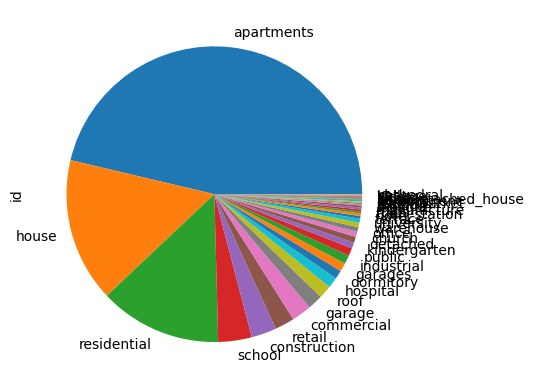

In [44]:
counts2.plot.pie(y = "count")
#counts2.plot.bar(y = "count")

By dropping the other residential kinds of buildings we can get an idea of what services are there in the city.

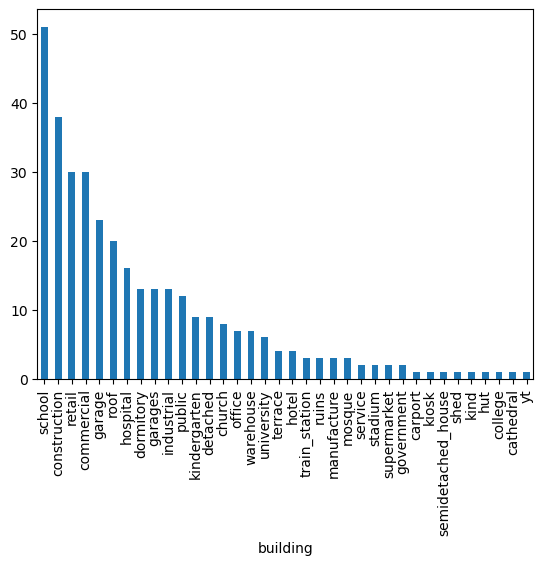

In [47]:
counts2.drop(['residential', 'apartments', 'house'], axis = 'index').plot.bar(y = "count")

In [12]:
buildings.explore(column = 'building')

In [49]:
import contextily as cx

In [51]:
nonresidential = buildings[(buildings.building != "yes") & (buildings.building != "residential") & (buildings.building != "house")]

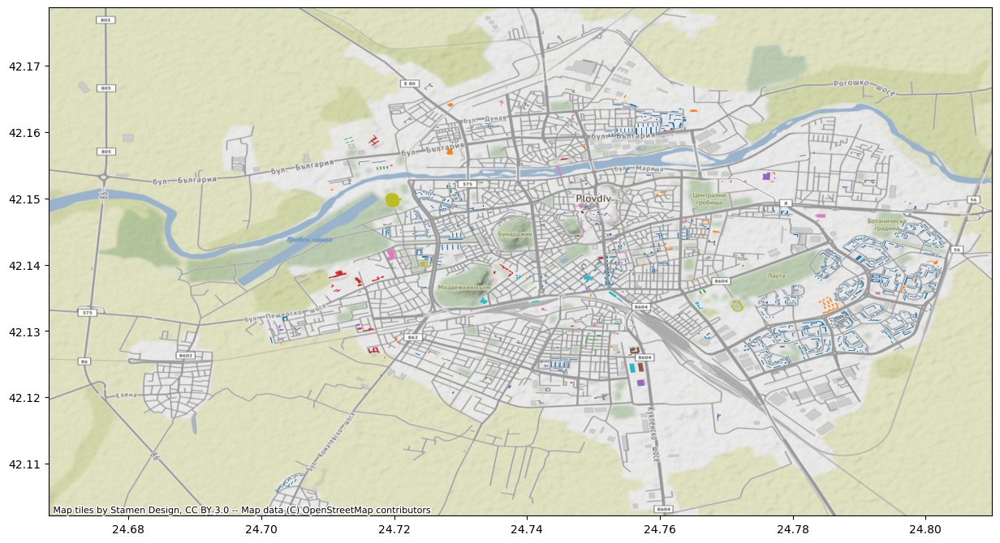

In [59]:
ax = nonresidential.plot(figsize=(15, 15), column = 'building')
cx.add_basemap(ax, crs=buildings.crs )# source=cx.providers.Stamen.TonerLite)

It looks like non-residential buildings are in places farther from the center

In [15]:
buildings.columns

Index(['addr:city', 'addr:country', 'addr:housenumber', 'addr:housename',
       'addr:postcode', 'addr:place', 'addr:street', 'email', 'name',
       'opening_hours', 'operator', 'phone', 'ref', 'url', 'website',
       'building', 'amenity', 'building:flats', 'building:levels', 'craft',
       'height', 'internet_access', 'office', 'shop', 'source', 'start_date',
       'wikipedia', 'id', 'timestamp', 'version', 'tags', 'osm_type',
       'geometry', 'changeset'],
      dtype='object')

In [16]:
#buildings.groupby(['building'])['building'].count().reset_index(name='count').sort_values(['count'], ascending=False)

## Landuse

c:\Users\User\anaconda3\envs\geospatialenv\lib\site-packages\geopandas\array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 (the single non-null crs provided).
  warnings.warn(


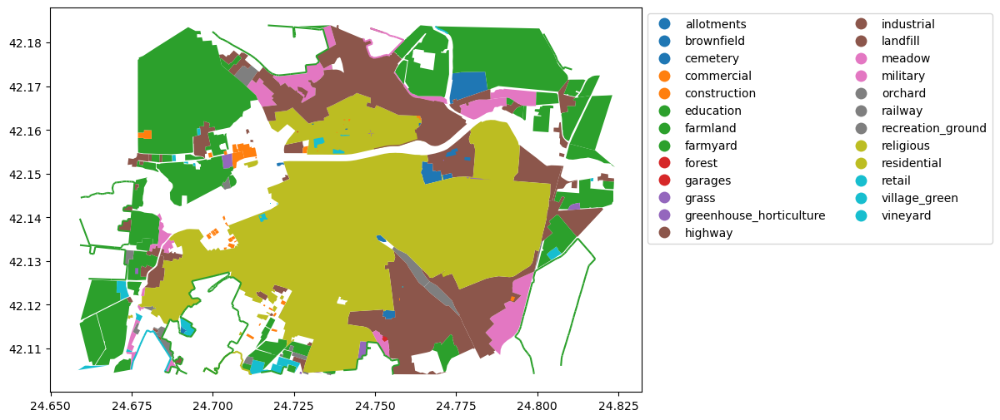

In [67]:
landuse = osm3.get_landuse()
landuse.plot(column='landuse', legend=True, legend_kwds=dict(loc='upper left', ncol=2, bbox_to_anchor=(1, 1)), figsize=(10,6))

In [18]:
landuse.crs

<Geographic 2D CRS: EPSG:4326>
Name: WGS 84
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: World.
- bounds: (-180.0, -90.0, 180.0, 90.0)
Datum: World Geodetic System 1984 ensemble
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

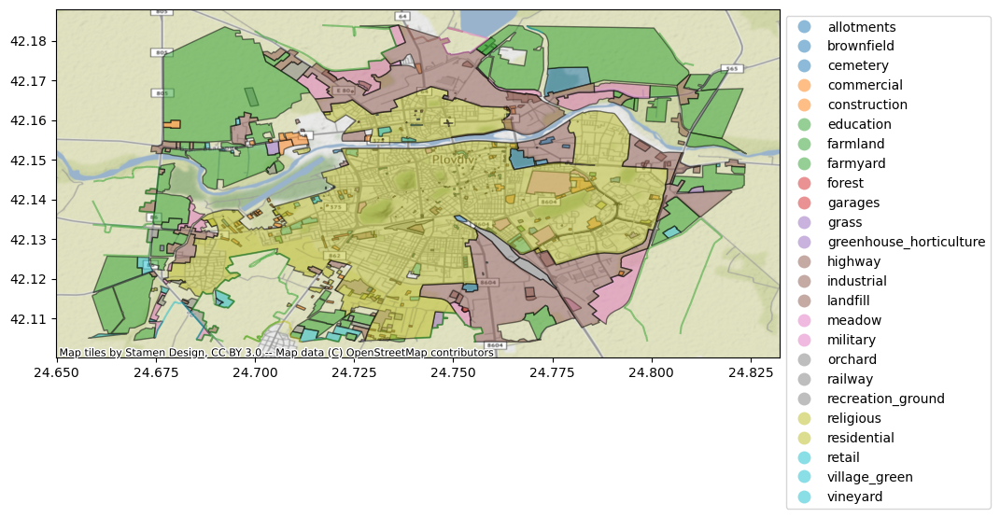

In [19]:
ax = landuse.plot(column = 'landuse', legend = True, legend_kwds=dict(loc='upper left', ncol=1, bbox_to_anchor=(1, 1)), figsize=(10, 10), alpha=0.5, edgecolor='k')
cx.add_basemap(ax, crs=landuse.crs )

In [20]:
landuse.explore(column = "landuse")

In [68]:
area = landuse.to_crs(epsg=32634).geometry.area
area = area / 10**6 #in sq km
#area.sort_values(ascending=False).head(10) 

In [69]:
landuse['area'] = area

In [70]:
landuse.groupby(['landuse'])['area'].sum().reset_index(name='sum').sort_values(['sum'], ascending=False)

,landuse,sum
21,residential,33.240397
6,farmland,21.395022
13,industrial,16.462308
15,meadow,3.252752
16,military,0.880402
2,cemetery,0.858480
4,construction,0.669402
17,orchard,0.665111
24,vineyard,0.626220
18,railway,0.610680


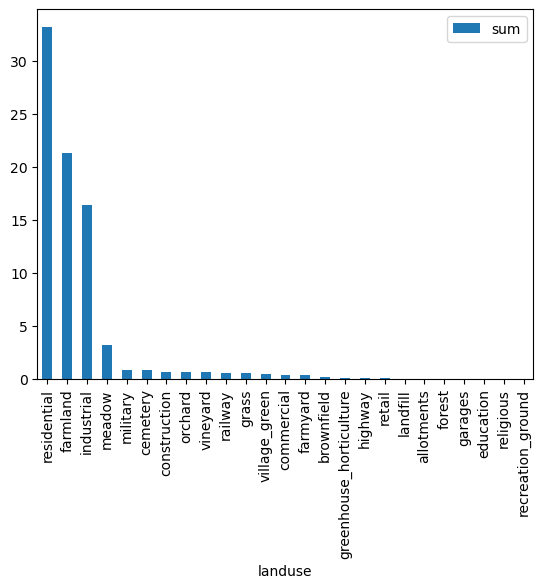

In [72]:
landuse.groupby(['landuse'])['area'].sum().reset_index(name='sum').sort_values(['sum'], ascending=False).plot.bar(y = "sum", x = "landuse")

In [24]:
landuse.landuse.unique()

array(['construction', 'military', 'cemetery', 'industrial', 'grass',
       'brownfield', 'railway', 'garages', 'education', 'orchard',
       'meadow', 'recreation_ground', 'religious', 'farmland',
       'village_green', 'residential', 'commercial', 'vineyard',
       'greenhouse_horticulture', 'farmyard', 'highway', 'retail',
       'forest', 'allotments', 'landfill'], dtype=object)

It seems the city is fairly well balanced in terms of greenery and industrial/urban factors.

In [25]:
residential = landuse[(landuse.landuse == "residential")]
industrial = landuse[(landuse.landuse == "industrial") ]

In [73]:
green_landuse = landuse[(landuse.landuse == "farmland") | (landuse.landuse == "forest")| (landuse.landuse == "grass")| (landuse.landuse == "greenfield")] # most important greenery

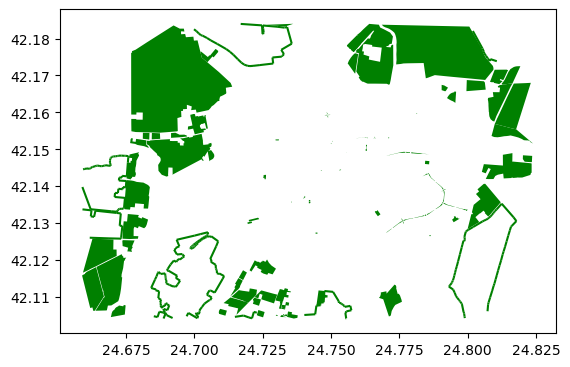

In [74]:
green_landuse.plot(color = "green") # Concentrated on the suburbs

In [79]:
#with open(r"C:\Users\User\Documents\UNITN\Geospatial\raster\green_landuse.geojson", 'w') as f:
#    f.write(green_landuse.to_json())

In [28]:
green_landuse['area'].sum()/landuse['area'].sum() #percentage of the greenery

0.27077458706659013

In [29]:
residential['area'].sum()/landuse['area'].sum() #percentage of the residential

0.4101243412751048

In [30]:
industrial['area'].sum()/landuse['area'].sum() #percentage of the industrial

0.2031140986076837

## Natural

c:\Users\User\anaconda3\envs\geospatialenv\lib\site-packages\pyrosm\pyrosm.py:382: ShapelyDeprecationWarning: The array interface is deprecated and will no longer work in Shapely 2.0. Convert the '.coords' to a numpy array instead.
  gdf = get_natural_data(
c:\Users\User\anaconda3\envs\geospatialenv\lib\site-packages\geopandas\array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 (the single non-null crs provided).
  warnings.warn(


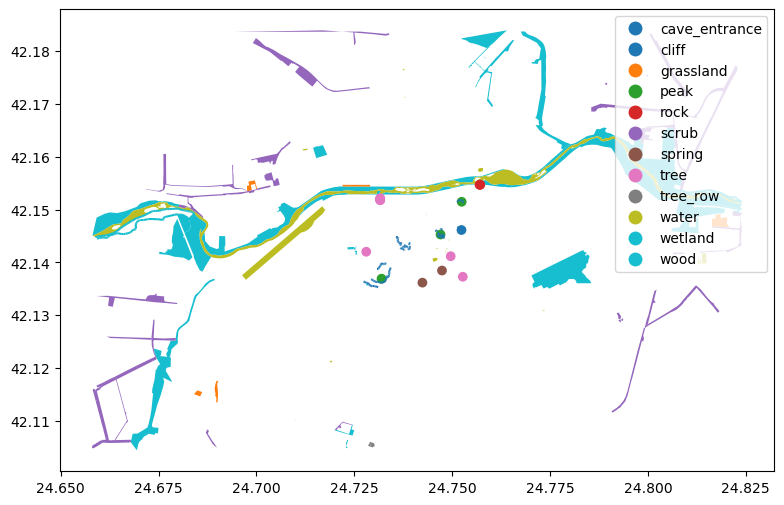

In [31]:
natural = osm3.get_natural()
natural.plot(column='natural', legend=True, figsize=(10,6))

## Network allocation

## Walking

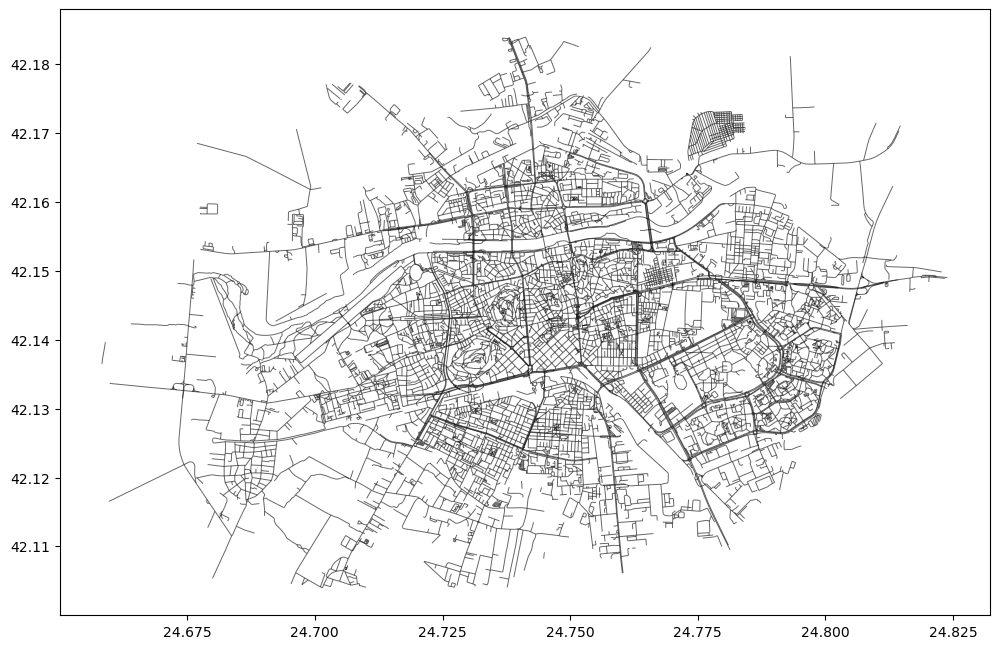

In [18]:
walk = osm3.get_network("walking", nodes = True)
walk[1].plot(color="k", figsize=(12,12), lw=0.7, alpha=0.6)

### Let's create the hortest path from shortest to highest point of the city.

The coordinates come from the elevation analysis

In [15]:
nodes, edges = osm3.get_network("walking", nodes = True)

In [16]:
network_onx = osm3.to_graph(nodes, edges,graph_type = "networkx")

In [19]:

df = pd.DataFrame({"Latitude": 42.136944, "Longitude": 24.731667}, index = [0])
pointmax = gpd.GeoDataFrame(
    df, geometry=gpd.points_from_xy(df.Longitude, df.Latitude), crs = walk[0].crs)
pointmax

,Latitude,Longitude,geometry
0,42.136944,24.731667,POINT (24.73167 42.13694)


In [20]:
df = pd.DataFrame({"Latitude": 42.143611, "Longitude": 24.686111}, index = [0])
pointmin = gpd.GeoDataFrame(
    df, geometry=gpd.points_from_xy(df.Longitude, df.Latitude), crs = walk[0].crs)
pointmin

,Latitude,Longitude,geometry
0,42.143611,24.686111,POINT (24.68611 42.14361)


In [21]:
pointnearmin = ox.distance.get_nearest_node(network_onx,(42.143611, 24.686111), method = "euclidean")
pointnearmax = ox.distance.get_nearest_node(network_onx,(42.136944,	24.731667), method = "euclidean")

In [22]:
shortest_path = ox.shortest_path(network_onx, pointnearmin, pointnearmax, weight="length")

In [23]:
shortest_path

[9733110888,
 9733110889,
 9733110890,
 9727454711,
 9727454712,
 9727454710,
 9727454709,
 9727454708,
 3869793721,
 3869793722,
 3869793723,
 3869793724,
 3869793725,
 3869793726,
 3869793727,
 3869793728,
 3869793729,
 3869793730,
 3869793731,
 3869793732,
 3869793733,
 9727454707,
 3869793734,
 2152998937,
 2152998933,
 2152998932,
 2152998929,
 2152998925,
 2152998922,
 2152998914,
 2154162721,
 2154162720,
 2154162719,
 2154162718,
 2154162717,
 1197091532,
 1197091764,
 2152998873,
 1197092066,
 1197091816,
 1197091996,
 2152998870,
 2152998871,
 2152998872,
 9757706356,
 2152998879,
 9280592552,
 2152998882,
 9253912524,
 9253912522,
 2994859368,
 2152998877,
 2040955535,
 2040955416,
 5617088353,
 2040597652,
 2040597649,
 2040597653,
 161398618,
 1026878769,
 1026878795,
 1329073575,
 1026878696,
 1026878729,
 1026878745,
 1026878779,
 1026878787,
 1026878700,
 1026878719,
 1026878755,
 1026878757,
 1026878793,
 571376279,
 1096846444,
 1329073600,
 571376283,
 3975957827,
 2

In [24]:


# function to create the route from the ids of the nodes
def route_nodes_to_line_networkx(nodelist, network,solution=1):
  points = []
  for idnode in nodelist:
    lon = network.nodes[idnode]['x']
    lat = network.nodes[idnode]['y']
    point = Point(lon,lat)
    points.append(point)
  path = LineString(points)
  route = gpd.GeoDataFrame(
    {"src_node": [nodelist[0]], "tgt_node": [nodelist[-1]], "solution": [solution]},
      geometry=[path],
      crs="epsg:4326"
  )
  return route

In [25]:
route_with_onx = route_nodes_to_line_networkx(shortest_path, network_onx)

In [30]:
route_with_onx.geometry.to_crs(32635).length # length of this route in metres

0    5387.92538
dtype: float64

Let's see where is the shortest path

In [66]:
route_with_onx.explore()

## Cycling

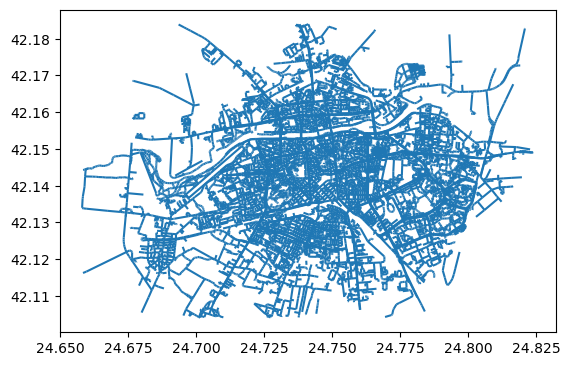

In [38]:
burgas_cycling = osm3.get_network(network_type = "cycling")
burgas_cycling['geom_type'] = burgas_cycling.geometry.geom_type
burgas_cycling.plot()

## Driving

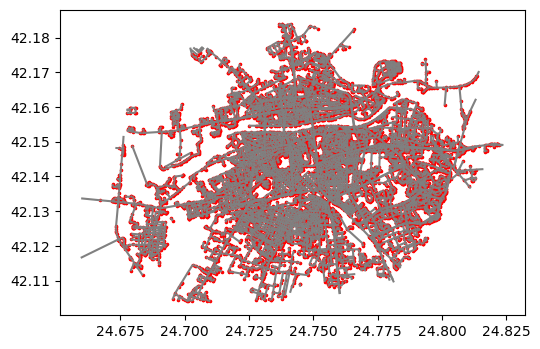

In [37]:
nodes, edges = osm3.get_network(nodes=True, network_type="driving")

# Plot nodes and edges on a map
ax = edges.plot(figsize=(6,6), color="gray")
ax = nodes.plot(ax=ax, color="red", markersize=2.5)